Plan of action:
1. Install dependencies
2. Read Data
3. Extract text from images
     * pytesseract
     * easyocr
     * keras_ocr
4. Run on a few examples and compare the results

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from glob import glob #for interacting with files

from tqdm.notebook import tqdm #to track our loops
from PIL import Image #for viewing images

plt.style.use('ggplot')

In [2]:
annot = pd.read_parquet('/kaggle/input/textocr-text-extraction-from-images-dataset/annot.parquet')
img = pd.read_parquet('/kaggle/input/textocr-text-extraction-from-images-dataset/img.parquet')
img_name = glob('/kaggle/input/textocr-text-extraction-from-images-dataset/train_val_images/train_images/*')

In [3]:
len(img_name)

25119

In [4]:
img_name[1]

'/kaggle/input/textocr-text-extraction-from-images-dataset/train_val_images/train_images/c613956f36cbd5cd.jpg'

In [5]:
plt.imread(img_name[0]) #read an image from a file and convert it into a NumPy array
"""
The array typically has three dimensions:
    The first dimension represents the image height.
    The second dimension represents the image width.
    The third dimension (usually of size 3) represents the color channels (red, green, and blue).
"""

'\nThe array typically has three dimensions:\n    The first dimension represents the image height.\n    The second dimension represents the image width.\n    The third dimension (usually of size 3) represents the color channels (red, green, and blue).\n'

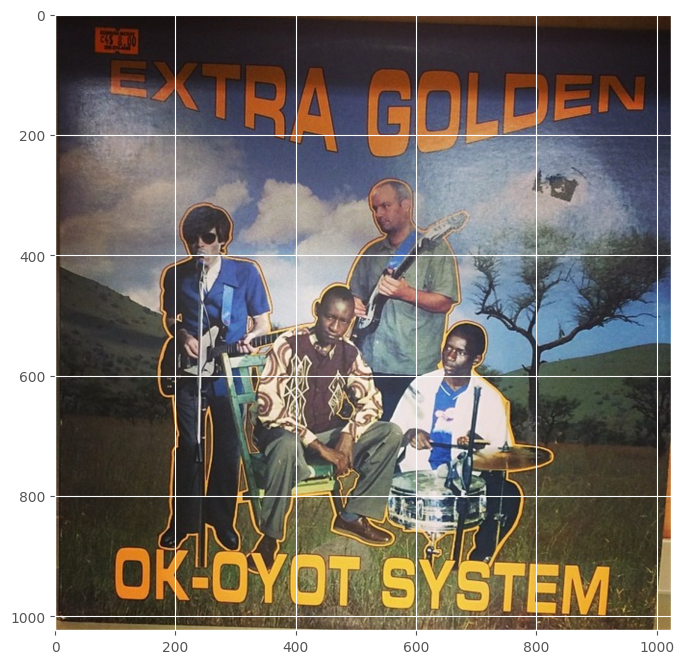

In [6]:
plt.figure(figsize=(8,8))
plt.imshow(plt.imread(img_name[0])) #show  the image

In [7]:
annot.head()
# the image id in annot dataframe is same as in img_name images id and so with in img dataframe

,id,image_id,bbox,utf8_string,points,area
0,a4ea732cd3d5948a_1,a4ea732cd3d5948a,"[525.83, 3.4, 197.64, 33.94]",Performance,"[525.83, 3.4, 723.47, 7.29, 722.76, 36.99, 525...",6707.90
1,a4ea732cd3d5948a_2,a4ea732cd3d5948a,"[534.67, 64.68, 91.22, 38.19]",Sport,"[535.73, 64.68, 623.41, 67.51, 625.89, 102.87,...",3483.69
2,a4ea732cd3d5948a_3,a4ea732cd3d5948a,"[626.95, 63.62, 96.52, 31.82]",Watch,"[626.95, 63.62, 721.7, 63.62, 723.47, 95.44, 6...",3071.27
3,a4ea732cd3d5948a_4,a4ea732cd3d5948a,"[577.4, 141.87, 147.13, 43.1]",...period.,"[580.02, 143.61, 724.53, 141.87, 723.66, 184.9...",6341.30
4,a4ea732cd3d5948a_5,a4ea732cd3d5948a,"[391.03, 163.9, 60.82, 38.65]",.,"[395.2, 163.9, 451.85, 191.94, 445.59, 202.55,...",2350.69


In [8]:
img.head()

,id,width,height,set,file_name
0,a4ea732cd3d5948a,840,1024,train,train/a4ea732cd3d5948a.jpg
1,4bf43a7b2a898044,1024,683,train,train/4bf43a7b2a898044.jpg
2,1b55b309b0f50d02,1024,683,train,train/1b55b309b0f50d02.jpg
3,00c359f294f7dcd9,1024,680,train,train/00c359f294f7dcd9.jpg
4,04b5a37f762b0f51,768,1024,train,train/04b5a37f762b0f51.jpg


In [9]:
#you can run this one by one to understand how did i get the image_id from img_name dataframe.
"""img_name[1]
img_name[1].split('/')
img_name[1].split('/')[-1]
img_name[1].split('/')[-1].split('.')""" 
img_id = img_name[0].split('/')[-1].split('.')[0]

In [10]:
img_id = img_name[0].split('/')[-1].split('.')[0]
annot[annot['image_id'] == img_id]


,id,image_id,bbox,utf8_string,points,area
674889,f644219f560e3778_1,f644219f560e3778,"[64.54, 22.34, 75.25, 47.22]",.,"[67.49, 22.34, 139.79, 28.25, 139.79, 69.56, 6...",3553.30
674890,f644219f560e3778_2,f644219f560e3778,"[68.97, 62.18, 419.03, 191.81]",EXTRA,"[77.82, 62.18, 488.0, 71.03, 483.57, 253.99, 6...",80374.14
674891,f644219f560e3778_3,f644219f560e3778,"[510.13, 81.36, 486.9, 180.01]",GOLDEN,"[511.6, 81.36, 995.55, 82.84, 997.03, 242.19, ...",87646.87
674892,f644219f560e3778_4,f644219f560e3778,"[89.63, 876.63, 432.3, 118.03]",OK-OYOT,"[91.1, 876.63, 521.93, 889.91, 521.93, 994.66,...",51024.37
674893,f644219f560e3778_5,f644219f560e3778,"[532.26, 892.86, 402.8, 118.03]",SYSTEM,"[532.26, 892.86, 935.06, 910.56, 930.63, 1010....",47542.48


In [11]:
print(len(annot[annot['image_id'] == img_id]))

5


**creating a function to display 20 such images**

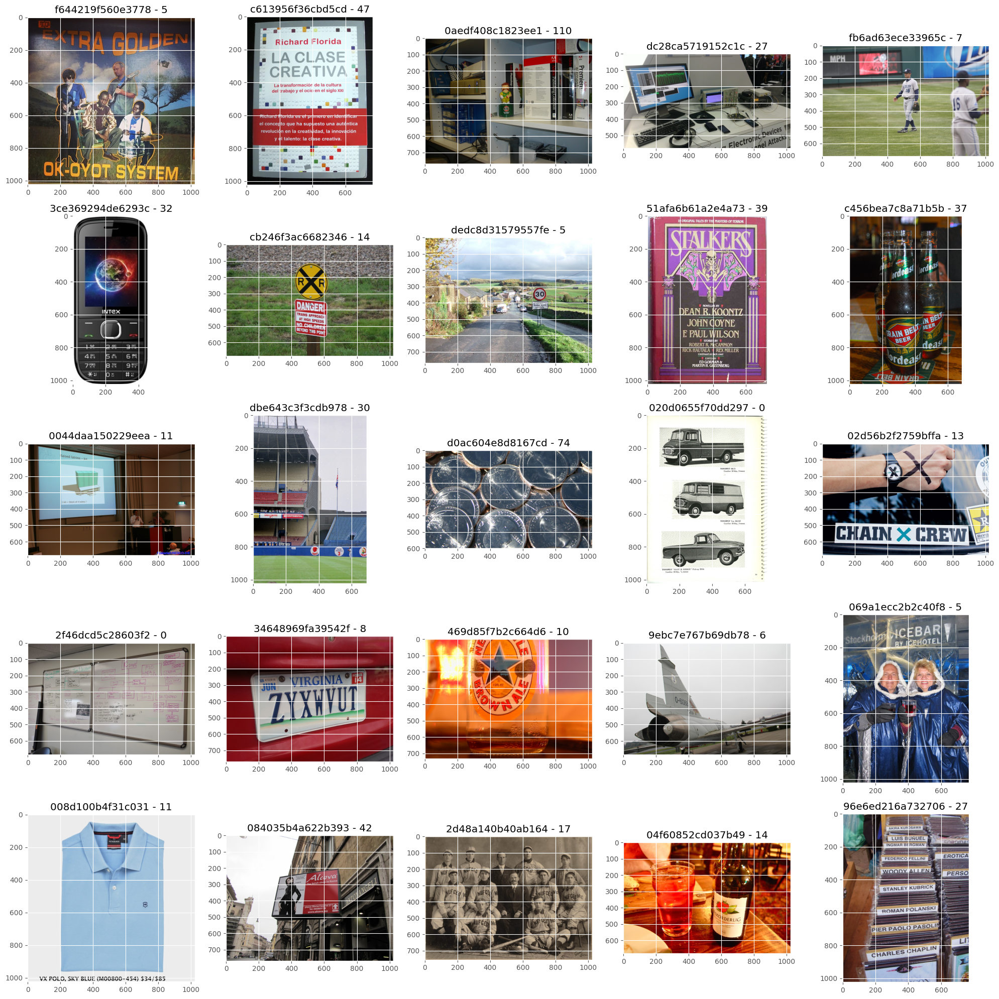

In [12]:
# Define the number of rows and columns
nrows = 5
ncols = 5

# Create a figure and subplots
fig, axes = plt.subplots(nrows, ncols, figsize=(20, 20))  # Adjust figsize as needed
axes = axes.flatten()

# Loop through the subplots and create plots
for i in range(25):
    axes[i].imshow(plt.imread(img_name[i]))
    img_id = img_name[i].split('/')[-1].split('.')[0]
    n_annot = len(annot[annot['image_id'] == img_id])
    axes[i].set_title(f"{img_id} - {n_annot}")  # Set title

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

### 1. Pytesseract

In [13]:
!pip install pytesseract opencv-python


In [14]:
import pytesseract
import cv2
# Read the image
#img = plt.imshow(plt.imread(img_name[0])) #show  the image
img_path = img_name[8]
img = cv2.imread(img_path)

# Convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply thresholding (optional, you might need to adjust the threshold value)
#thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)[1]

# Extract the text using Tesseract
text = pytesseract.image_to_string(gray)

# Print the extracted text
print(text)

Pua er rn

 

NN i rae
JOHN COYNE
MULL Se

Osi 1% een
HATeit HAUTALA = eis IBD Ast

Peay
ED GORMAN &
LIN Te ta Tia = — ee

{ ~J



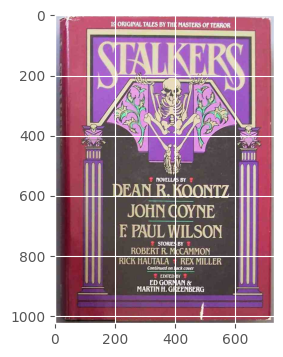

In [15]:
plt.figure(figsize=(4,4))
plt.imshow(plt.imread(img_name[8])) #show  the image

After trying for different images I got to knnow that it is not performing well, just there is a lil improvement in document type of image

### 2. EasyOCR

In [16]:
import easyocr
# Create a reader object (specify language(s) or leave empty for auto-detection)
reader = easyocr.Reader(['en'],gpu= True)  # Replace 'en' with desired language(s) or leave empty for auto-detection

# Read the image and extract text
result = reader.readtext(img_name[8])

# Access extracted data
for text, bounding_box, confidence in result:
    print(f"Text: {text}\nBounding Box: {bounding_box}\nConfidence: {confidence}")
ocr_df = pd.DataFrame(result,columns = ['bbox','text','conf'])


Text: [[180, 16], [590, 16], [590, 48], [180, 48]]
Bounding Box: 19 ORIGINAL TALES By THE MASTERSOF TERROR
Confidence: 0.6843497301403118
Text: [[118, 66], [656, 66], [656, 258], [118, 258]]
Bounding Box: SEALKTRS 
Confidence: 0.07108899876897115
Text: [[330, 534], [442, 534], [442, 558], [330, 558]]
Bounding Box: NOVELLAS BY
Confidence: 0.7703618729153122
Text: [[181, 553], [379, 553], [379, 613], [181, 613]]
Bounding Box: DEAN R
Confidence: 0.9671599726915385
Text: [[383, 555], [591, 555], [591, 617], [383, 617]]
Bounding Box: KOONTZ
Confidence: 0.9978988254647739
Text: [[233, 621], [541, 621], [541, 683], [233, 683]]
Bounding Box: JOHN COYNE
Confidence: 0.7685226729578194
Text: [[203, 687], [566, 687], [566, 750], [203, 750]]
Bounding Box: E PAUL WILSON
Confidence: 0.9073906372842531
Text: [[336, 748], [430, 748], [430, 772], [336, 772]]
Bounding Box: STORIES BY
Confidence: 0.9739449720702803
Text: [[247, 767], [523, 767], [523, 803], [247, 803]]
Bounding Box: ROBERT R McCAMMON
Conf

In [17]:
ocr_df

,bbox,text,conf
0,"[[180, 16], [590, 16], [590, 48], [180, 48]]",19 ORIGINAL TALES By THE MASTERSOF TERROR,0.684350
1,"[[118, 66], [656, 66], [656, 258], [118, 258]]",SEALKTRS,0.071089
2,"[[330, 534], [442, 534], [442, 558], [330, 558]]",NOVELLAS BY,0.770362
3,"[[181, 553], [379, 553], [379, 613], [181, 613]]",DEAN R,0.967160
4,"[[383, 555], [591, 555], [591, 617], [383, 617]]",KOONTZ,0.997899
5,"[[233, 621], [541, 621], [541, 683], [233, 683]]",JOHN COYNE,0.768523
6,"[[203, 687], [566, 687], [566, 750], [203, 750]]",E PAUL WILSON,0.907391
7,"[[336, 748], [430, 748], [430, 772], [336, 772]]",STORIES BY,0.973945
8,"[[247, 767], [523, 767], [523, 803], [247, 803]]",ROBERT R McCAMMON,0.998884
9,"[[206, 802], [384, 802], [384, 834], [206, 834]]",RICK HAUTALA,0.694570


as we can see EasyOCR was able to pull 14 text from the image.

### 3. KerasOCR

In [18]:
!pip install keras-ocr -q

In [19]:
from keras_ocr import pipeline

# Replace with the path to your image file
image_path = img_name[8]

# Create the OCR pipeline (download weights automatically)
pipeline = pipeline.Pipeline()

# Recognize text from the image
predictions = pipeline.recognize([img_name[8]])
pd.DataFrame(predictions[0],columns = ['text','box'])


2024-02-24 15:54:06.076766: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-24 15:54:06.076889: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-24 15:54:06.251808: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5
2/2 [==============================] - 8s 1s/step


,text,box
0,19,"[[182.0, 19.0], [205.0, 19.0], [205.0, 39.0], ..."
1,original,"[[205.0, 19.0], [290.0, 19.0], [290.0, 40.0], ..."
2,tales,"[[288.99997, 19.999998], [343.99997, 20.0], [3..."
3,by,"[[344.0, 21.0], [370.0, 21.0], [370.0, 41.0], ..."
4,the,"[[369.0, 21.0], [406.0, 21.0], [406.0, 41.0], ..."
5,masters,"[[407.09824, 20.616896], [488.27902, 21.86583]..."
6,of,"[[487.0, 23.0], [514.0, 23.0], [514.0, 43.0], ..."
7,terror,"[[513.0, 23.0], [587.0, 23.0], [587.0, 45.0], ..."
8,stalkers,"[[140.73863, 91.50181], [634.79785, 90.3227], ..."
9,novellas,"[[333.0, 538.0], [414.0, 538.0], [414.0, 556.0..."


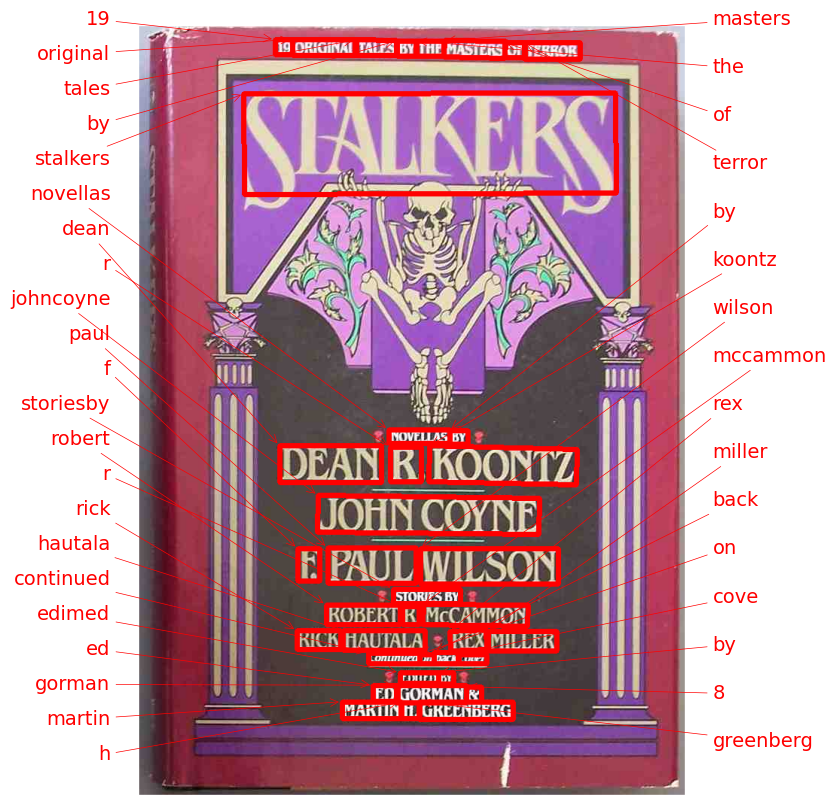

In [20]:
#keras has inbuilt funciton to draw annotations
import keras_ocr
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_name[8]),predictions[0],ax=ax)
plt.show()

### Comparing the result of easyOCR and KerasOCR

In [21]:
#easyOCR
import easyocr
easyocr_df=[]
reader = easyocr.Reader(['en'],gpu= True)  # Replace 'en' with desired language(s) or leave empty for auto-detection
dfs=[]
for image in tqdm(img_name[:25]):
      
    # Read the image and extract text
    result = reader.readtext(image)

    img_id = image.split('/')[-1].split('.')[0]
    image_df = pd.DataFrame(result, columns = ['bbox','text','conf'])
    image_df['image_id'] = img_id
    dfs.append(image_df)
easyocr_df= pd.concat(dfs)


  0%|          | 0/25 [00:00<?, ?it/s]

In [22]:
easyocr_df['image_id'].unique()

array(['f644219f560e3778', 'c613956f36cbd5cd', '0aedf408c1823ee1',
       'dc28ca5719152c1c', 'fb6ad63ece33965c', '3ce369294de6293c',
       'cb246f3ac6682346', 'dedc8d31579557fe', '51afa6b61a2e4a73',
       'c456bea7c8a71b5b', '0044daa150229eea', 'dbe643c3f3cdb978',
       'd0ac604e8d8167cd', '020d0655f70dd297', '02d56b2f2759bffa',
       '2f46dcd5c28603f2', '34648969fa39542f', '469d85f7b2c664d6',
       '9ebc7e767b69db78', '069a1ecc2b2c40f8', '008d100b4f31c031',
       '084035b4a622b393', '2d48a140b40ab164', '04f60852cd037b49',
       '96e6ed216a732706'], dtype=object)

In [23]:
#keras_ocr
from keras_ocr import pipeline
# Create the OCR pipeline (download weights automatically)
pipeline = pipeline.Pipeline()
keras_ocr_df=[]
dfs=[]
for image in tqdm(img_name[:25]):

    # Recognize text from the image
    predictions = pipeline.recognize([image])
    predictions = predictions[0]
    img_id = image.split('/')[-1].split('.')[0]
    image_df = pd.DataFrame(predictions, columns = ['text','bbox'])
    image_df['image_id'] = img_id
    dfs.append(image_df)
keras_ocr_df= pd.concat(dfs)
    



Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


  0%|          | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 70ms/step


### Plot Results

In [24]:
result[1]

([[296, 136], [508, 136], [508, 168], [296, 168]],
 'LUIS BUNUEL',
 0.9972454058225716)

In [25]:
predictions[0]


('kurosawa',
 array([[352.4792 ,  77.11543],
        [477.77075,  73.00752],
        [478.4027 ,  92.28189],
        [353.11115,  96.3898 ]], dtype=float32))

In [26]:
def plot_comparison(img_name,easyocr_df,keras_ocr_df):
    fig,axis = plt.subplots(1,2,figsize = (15,10))
    img_id = img_name.split('/')[-1].split('.')[0]
    easy_results = easyocr_df[easyocr_df['image_id'] == img_id][['text','bbox']].values.tolist()
    easy_results = [(x[0],np.array(x[1])) for x in easy_results] 
    keras_ocr.tools.drawAnnotations(plt.imread(img_name),easy_results,ax=axis[0])
    axis[0].set_title('easyocr_results',fontsize = 24)

    keras_results = keras_ocr_df[keras_ocr_df['image_id'] == img_id][['text','bbox']].values.tolist()
    keras_results = [(x[0],np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_name),keras_results,ax=axis[1])
    axis[1].set_title('kerasOCR_results',fontsize = 24)
    
    plt.show()


    




### Explanation of the above code
The function aims to visually compare the text detection and recognition results from both EasyOCR and Keras OCR on the same image. Here's a breakdown of the steps involved:

* **Extracting image ID and results**:

    * The code splits the img_name to extract the image ID from the filename.
    * It then filters the easyocr_df and keras_ocr_df DataFrames to select rows where the image_id matches the extracted ID.
    * The filtered DataFrames containing text and bounding box information for each detected object are converted into lists of tuples.
    
* **Plotting the image and annotations**:

    * The function creates a figure with two subplots using plt.subplots.
    * It reads the image using plt.imread and displays it on the first subplot.
    * For each library (EasyOCR and Keras OCR):
        * The code uses the keras_ocr.tools.drawAnnotations function to draw bounding boxes and corresponding text labels on the image based on the extracted results.
        * Each subplot is then assigned a title indicating the corresponding library's results.

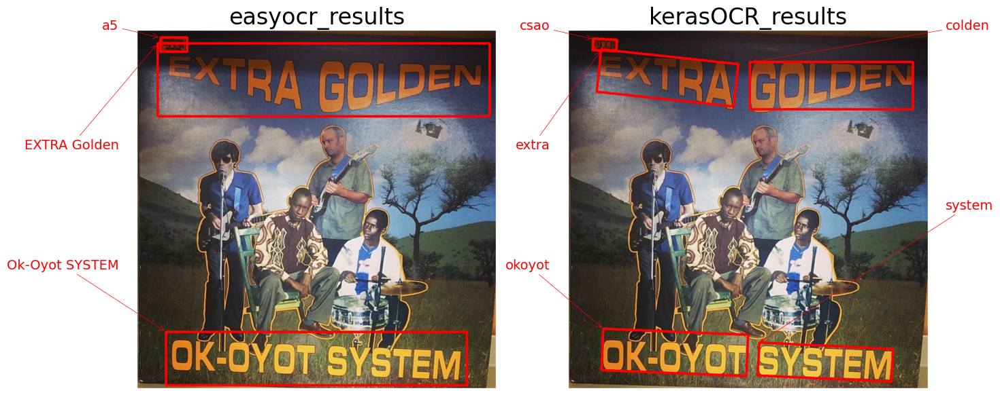

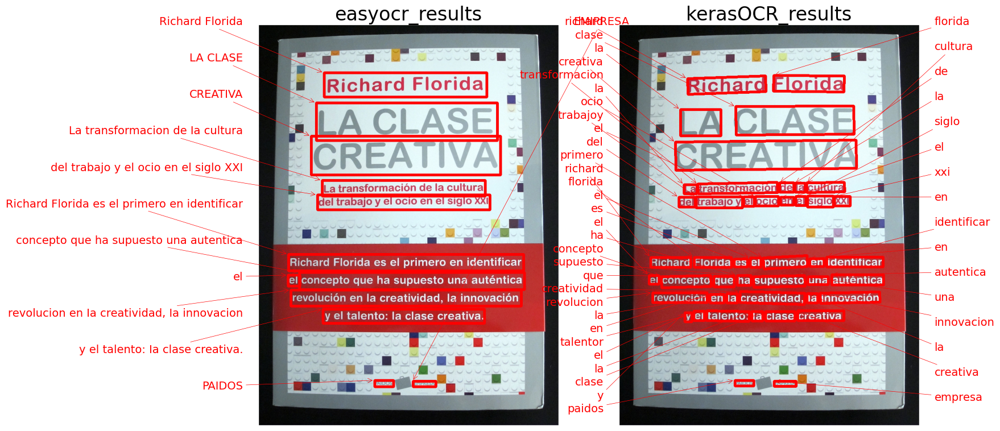

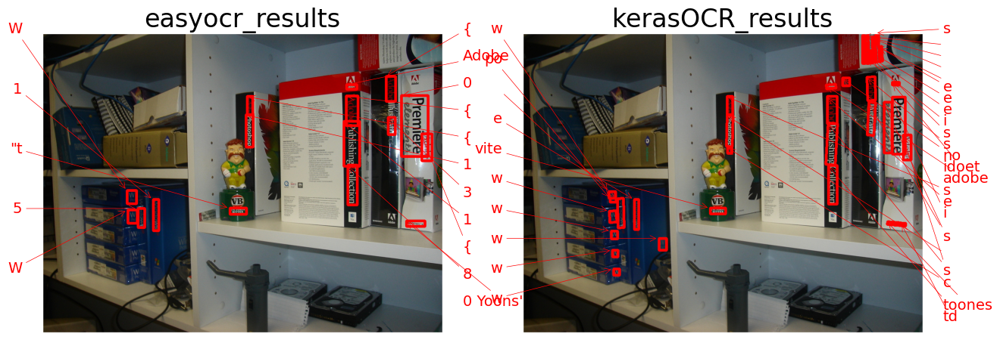

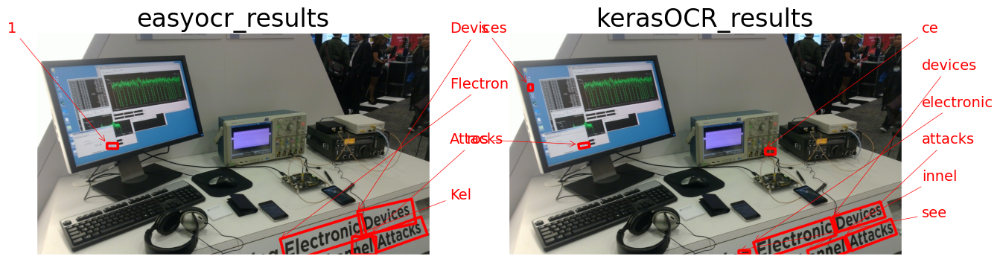

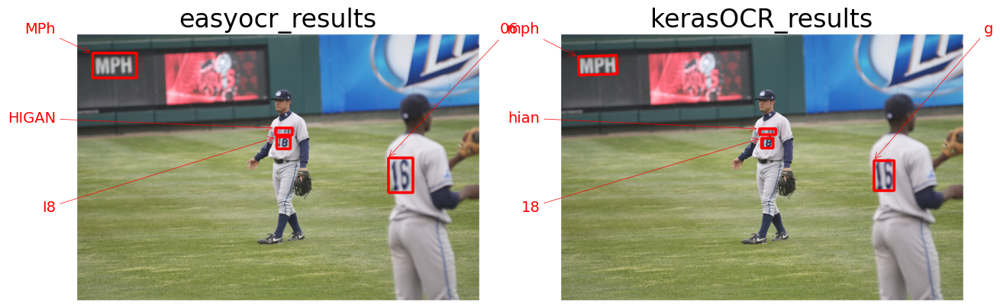

...

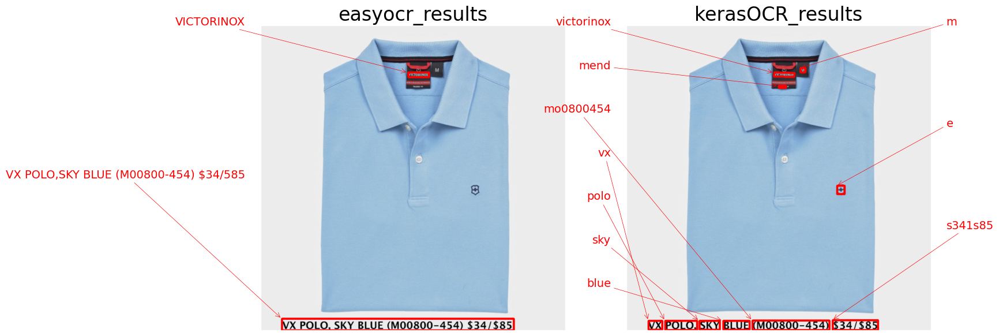

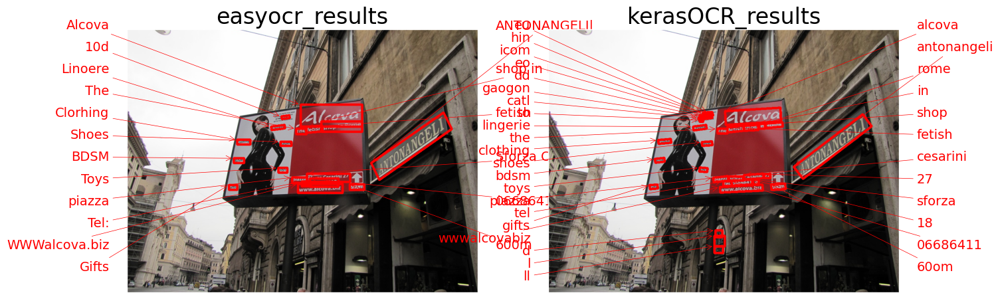

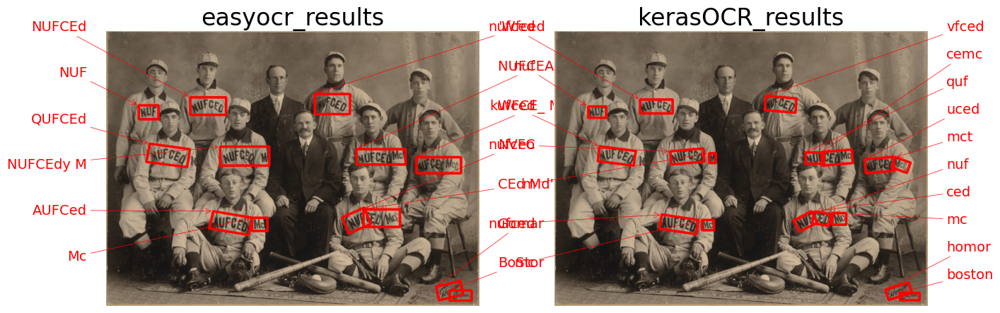

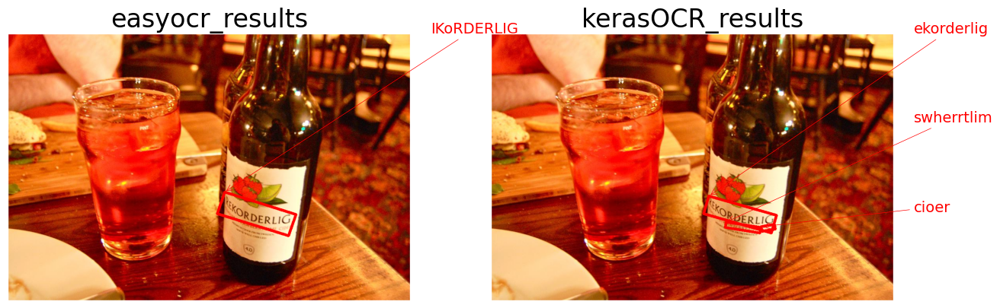

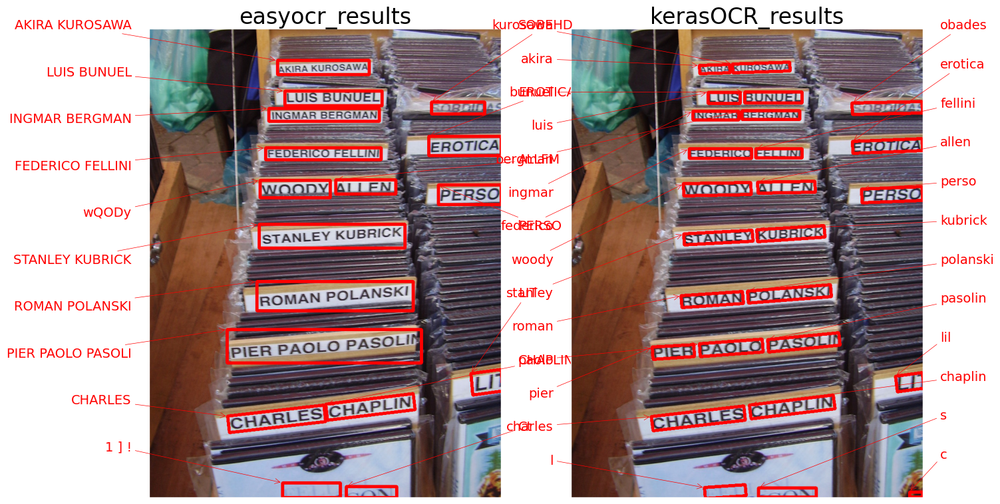

In [27]:
for image in img_name[:25]:
    plot_comparison(image,easyocr_df,keras_ocr_df)